# Trajectory Inference with StaVIA

VIA is a single-cell Trajectory Inference method that offers topology construction, pseudotimes, automated terminal state prediction and automated plotting of temporal gene dynamics along lineages. Here, we have improved the original author's colouring logic and user habits so that users can use the anndata object directly for analysis。 

We have completed this tutorial using the analysis provided by the original VIA authors.

Paper: [Generalized and scalable trajectory inference in single-cell omics data with VIA](https://www.nature.com/articles/s41467-021-25773-3)

Code: https://github.com/ShobiStassen/VIA

Colab_Reproducibility：https://colab.research.google.com/drive/1A2X23z_RLJaYLbXaiCbZa-fjNbuGACrD?usp=sharing

In [1]:
import scanpy as sc
import omicverse as ov
from omicverse.externel import VIA

import matplotlib.pyplot as plt
ov.plot_set()

2024-12-17 22:11:11.424575: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-17 22:11:11.437861: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-17 22:11:11.441926: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-17 22:11:11.452071: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-12-17 22:11:12.247725: W tensorflow/compiler/tf2


   ____            _     _    __                  
  / __ \____ ___  (_)___| |  / /__  _____________ 
 / / / / __ `__ \/ / ___/ | / / _ \/ ___/ ___/ _ \ 
/ /_/ / / / / / / / /__ | |/ /  __/ /  (__  )  __/ 
\____/_/ /_/ /_/_/\___/ |___/\___/_/  /____/\___/                                              

Version: 1.6.9, Tutorials: https://omicverse.readthedocs.io/
Dependency error: (pydeseq2 0.4.11 (/mnt/home/zehuazeng/software/rsc/lib/python3.10/site-packages), Requirement.parse('pydeseq2<=0.4.0,>=0.3'))


## Preprocess data

As an example, we apply differential kinetic analysis to dentate gyrus neurogenesis, which comprises multiple heterogeneous subpopulations.

In [2]:
import scvelo as scv
adata=scv.datasets.dentategyrus()
adata

AnnData object with n_obs × n_vars = 2930 × 13913
    obs: 'clusters', 'age(days)', 'clusters_enlarged'
    uns: 'clusters_colors'
    obsm: 'X_umap'
    layers: 'ambiguous', 'spliced', 'unspliced'

In [3]:
adata=ov.pp.preprocess(adata,mode='shiftlog|pearson',n_HVGs=2000,)
adata.raw = adata
adata = adata[:, adata.var.highly_variable_features]
ov.pp.scale(adata)
ov.pp.pca(adata,layer='scaled',n_pcs=50)

Begin robust gene identification
After filtration, 13264/13913 genes are kept.     Among 13264 genes, 13189 genes are robust.
End of robust gene identification.
Begin size normalization: shiftlog and HVGs selection pearson
normalizing counts per cell. The following highly-expressed genes are not considered during normalization factor computation:
['Hba-a1', 'Malat1', 'Ptgds', 'Hbb-bt']
    finished (0:00:00)
extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'highly_variable_nbatches', int vector (adata.var)
    'highly_variable_intersection', boolean vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'residual_variances', float vector (adata.var)
Time to analyze data in cpu: 1.2880923748016357 seconds.
End of size normalization: shiftlog and HVGs selection pearson
... as `zero_center=True`, sparse input is densified and may lead to larg

In [4]:
ov.pp.neighbors(adata,use_rep='scaled|original|X_pca',n_neighbors=15,n_pcs=30)
ov.pp.umap(adata,min_dist=1)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:03)


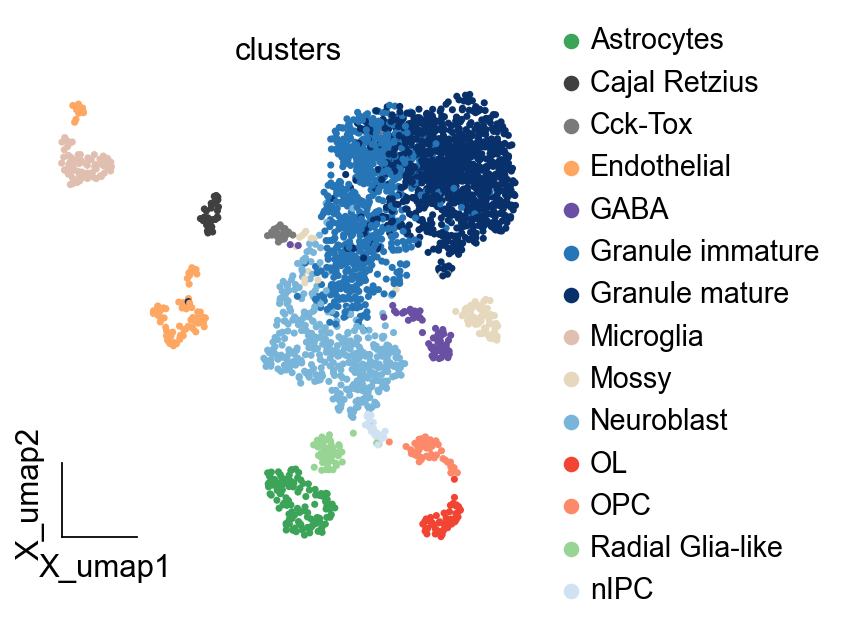

In [5]:
ov.pl.embedding(adata,basis='X_umap',
                   color=['clusters'],
                   frameon='small',cmap='Reds')

## Model construct and run

We need to specify the cell feature vector `use_rep` used for VIA inference, which can be X_pca, X_scVI or X_glue, depending on the purpose of your analysis, here we use X_pca directly. We also need to specify how many components to be used, the components should not larger than the length of vector.

Besides, we need to specify the `clusters` to be colored and calculate for VIA. If the `root_user` is None, it will be calculated the root cell automatically.

We need to set `basis` argument stored in `adata.obsm`. An example setting `tsne` because it stored in `obsm: 'tsne', 'MAGIC_imputed_data', 'palantir_branch_probs', 'X_pca'`

We also need to set `clusters` argument stored in `adata.obs`. It means the celltype key.

Other explaination of argument and attributes could be found at https://pyvia.readthedocs.io/en/latest/notebooks/ViaJupyter_scRNA_Hematopoiesis.html

**StaVia for time-series**
- [Via 2.0 Cartography on Mouse Gastrulation](https://pyvia.readthedocs.io/en/latest/notebooks/Via2.0%20Cartographic%20Mouse%20Gastrualation.html)
- [Via 2.0 Cartography on Zebrahub (Trajectory Inference)](https://pyvia.readthedocs.io/en/latest/notebooks/Zebrahub%20TI%20tutorial.html)
- [Via 2.0 Cartography on Zebrahub (Visualization)](https://pyvia.readthedocs.io/en/latest/notebooks/Zebrahub_tutorial_visualization.html)

**StaVia for spatial-temporal**
- [Stavia Spatially aware cartography on MERFISH](https://pyvia.readthedocs.io/en/latest/notebooks/StaVia%20MERFISH%202.html)
- [StaVia TI for Spatio-temporal Analysis of single cell data](https://pyvia.readthedocs.io/en/latest/notebooks/Zesta_jp_tutorial.html)

In [7]:
ncomps=30
knn=15
v0_random_seed=4
root_user = ['nIPC'] #the index of a cell belonging to the nIPC cell type
memory = 10
dataset = ''
use_rep = 'scaled|original|X_pca'
clusters = 'clusters'
basis='X_umap'

'''
#NOTE1, if you decide to choose a cell type as a root, then you need to set the dataset as 'group'
#root_user=['HSC1']
#dataset = 'group'# 'humanCD34'
#NOTE2, if rna-velocity is available, considering using it to compute the root automatically- see RNA velocity tutorial
'''

v0 = VIA.core.VIA(data=adata.obsm[use_rep][:, 0:ncomps], 
             true_label=adata.obs[clusters], 
             edgepruning_clustering_resolution=0.15, cluster_graph_pruning=0.15,
             knn=knn,  root_user=root_user, resolution_parameter=1.5,
             dataset=dataset, random_seed=v0_random_seed, memory=memory)#, do_compute_embedding=True, embedding_type='via-atlas')

v0.run_VIA()

2024-12-17 22:11:27.482502	Running VIA over input data of 2930 (samples) x 30 (features)
2024-12-17 22:11:27.482702	Knngraph has 15 neighbors
2024-12-17 22:11:28.362572	Finished global pruning of 15-knn graph used for clustering at level of 0.15. Kept 43.8 % of edges. 
2024-12-17 22:11:28.372474	Number of connected components used for clustergraph  is 1
2024-12-17 22:11:28.414405	Commencing community detection
2024-12-17 22:11:28.442355	Finished community detection. Found 537 clusters.
2024-12-17 22:11:28.443432	Merging 496 very small clusters (<10)
2024-12-17 22:11:28.448058	Finished detecting communities. Found 41 communities
2024-12-17 22:11:28.448207	Making cluster graph. Global cluster graph pruning level: 0.15
2024-12-17 22:11:28.452444	Graph has 1 connected components before pruning
2024-12-17 22:11:28.454240	Graph has 14 connected components after pruning
2024-12-17 22:11:28.462075	Graph has 1 connected components after reconnecting
2024-12-17 22:11:28.462528	0.0% links trimmed

2024-12-17 22:11:33.895472: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-17 22:11:33.895472: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-17 22:11:33.909212: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-17 22:11:33.909212: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-17 22:11:33.913315: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory


   ____            _     _    __                  
  / __ \____ ___  (_)___| |  / /__  _____________ 
 / / / / __ `__ \/ / ___/ | / / _ \/ ___/ ___/ _ \ 
/ /_/ / / / / / / / /__ | |/ /  __/ /  (__  )  __/ 
\____/_/ /_/ /_/_/\___/ |___/\___/_/  /____/\___/                                              

Version: 1.6.9, Tutorials: https://omicverse.readthedocs.io/

   ____            _     _    __                  
  / __ \____ ___  (_)___| |  / /__  _____________ 
 / / / / __ `__ \/ / ___/ | / / _ \/ ___/ ___/ _ \ 
/ /_/ / / / / / / / /__ | |/ /  __/ /  (__  )  __/ 
\____/_/ /_/ /_/_/\___/ |___/\___/_/  /____/\___/                                              

Version: 1.6.9, Tutorials: https://omicverse.readthedocs.io/
2024-12-17 22:11:38.555779	Ended all multiprocesses, will retrieve and reshape
2024-12-17 22:11:38.575738	start computing walks with rw2 method


  0%|          | 0/1300 [00:00<?, ?it/s]

memory for rw2 hittings times  2. Using rw2 based pt
2024-12-17 22:11:43.823114	Identifying terminal clusters corresponding to unique lineages...
2024-12-17 22:11:43.823133	Closeness:[8, 10, 11, 15, 16, 19, 20, 21, 25, 28, 31, 36, 38, 40]
2024-12-17 22:11:43.823144	Betweenness:[2, 4, 5, 6, 7, 8, 10, 11, 12, 14, 15, 16, 17, 19, 20, 22, 25, 28, 29, 30, 31, 34, 36, 38, 39]
2024-12-17 22:11:43.823152	Out Degree:[4, 5, 7, 8, 10, 11, 14, 15, 16, 17, 19, 20, 21, 24, 25, 26, 28, 29, 30, 31, 34, 36, 38, 40]
2024-12-17 22:11:43.823468	Terminal clusters corresponding to unique lineages in this component are [34, 4, 5, 36, 7, 8, 38, 11, 14, 19, 25, 28, 29, 30, 31] 
2024-12-17 22:11:43.823487	Calculating lineage probability at memory 10


  0%|          | 0/1000 [00:00<?, ?it/s]

2024-12-17 22:11:47.680175	Cluster or terminal cell fate 34 is reached 273.0 times
2024-12-17 22:11:47.724705	Cluster or terminal cell fate 4 is reached 411.0 times
2024-12-17 22:11:47.771439	Cluster or terminal cell fate 5 is reached 100.0 times
2024-12-17 22:11:47.819929	36 cluster/state is never reached. try increase number of KNN (which will increase number of edges) or try to increase the value of jac_std_global and cluster_graph_pruning which will lower edge pruning
2024-12-17 22:11:47.851444	Cluster or terminal cell fate 7 is reached 817.0 times
2024-12-17 22:11:47.899134	8 cluster/state is never reached. try increase number of KNN (which will increase number of edges) or try to increase the value of jac_std_global and cluster_graph_pruning which will lower edge pruning
2024-12-17 22:11:47.947328	Cluster or terminal cell fate 38 is reached 1.0 times
2024-12-17 22:11:47.994771	Cluster or terminal cell fate 11 is reached 40.0 times
2024-12-17 22:11:48.039502	Cluster or terminal ce

## Visualize and analysis

Before the subsequent analysis, we need to specify the colour of each cluster. Here we use sc.pl.embedding to automatically colour each cluster, if you need to specify your own colours, specify the palette parameter

tune edges False


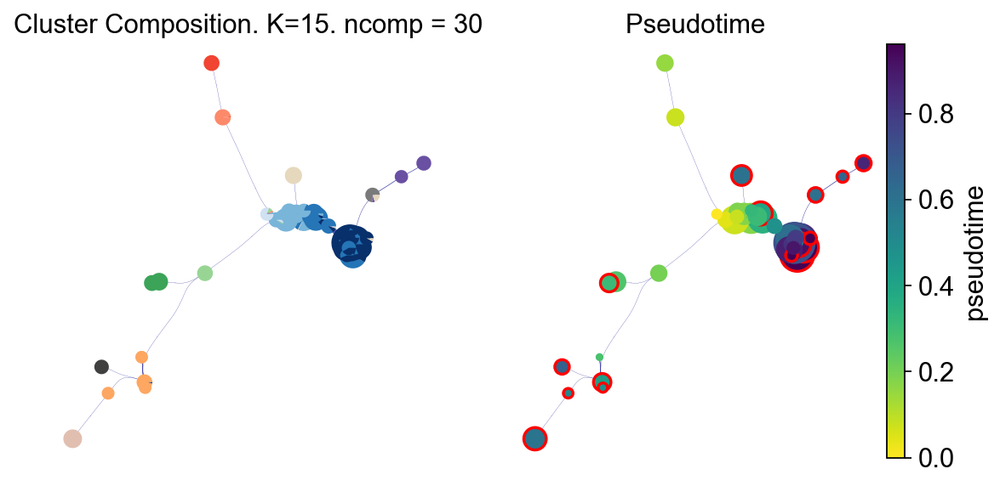

In [8]:
fig, ax, ax1 = VIA.core.plot_piechart_viagraph_ov(adata,clusters='clusters',dpi=80,
                                             via_object=v0, ax_text=False,show_legend=False)
fig.set_size_inches(8,4)

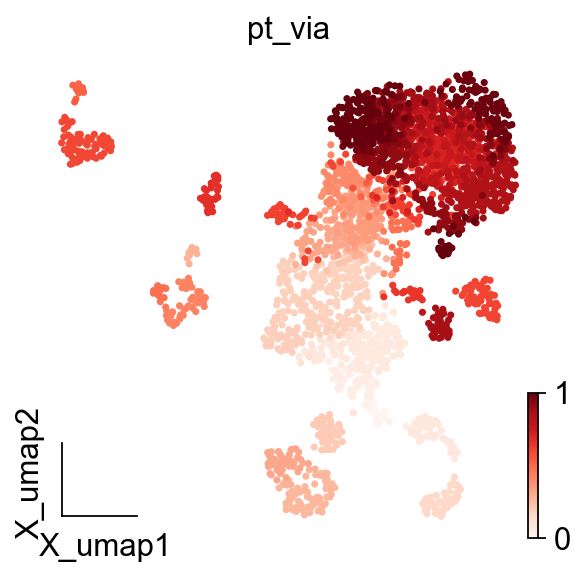

In [9]:
adata.obs['pt_via']=v0.single_cell_pt_markov
ov.pl.embedding(adata,basis='X_umap',
                   color=['pt_via'],
                   frameon='small',cmap='Reds')

## Trajectory projection

Visualize the overall VIA trajectory projected onto a 2D embedding (UMAP, Phate, TSNE etc) in different ways.

1. Draw the high-level clustergraph abstraction onto the embedding;
2. Draw high-edge resolution directed graph
3. Draw a vector field/stream plot of the more fine-grained directionality of cells along the trajectory projected onto an embedding.

Key Parameters:
- scatter_size
- scatter_alpha
- linewidth
- draw_all_curves (if too crowded, set to False)

In [10]:
clusters='clusters'
color_true_list=adata.uns['{}_colors'.format(clusters)]

2024-12-17 21:32:16.116402	Super cluster 4 is a super terminal with sub_terminal cluster 34
2024-12-17 21:32:16.116705	Super cluster 5 is a super terminal with sub_terminal cluster 4
2024-12-17 21:32:16.116761	Super cluster 7 is a super terminal with sub_terminal cluster 5
2024-12-17 21:32:16.116808	Super cluster 8 is a super terminal with sub_terminal cluster 36
2024-12-17 21:32:16.116859	Super cluster 11 is a super terminal with sub_terminal cluster 7
2024-12-17 21:32:16.116910	Super cluster 14 is a super terminal with sub_terminal cluster 8
2024-12-17 21:32:16.117002	Super cluster 16 is a super terminal with sub_terminal cluster 38
2024-12-17 21:32:16.117057	Super cluster 19 is a super terminal with sub_terminal cluster 11
2024-12-17 21:32:16.117118	Super cluster 25 is a super terminal with sub_terminal cluster 14
2024-12-17 21:32:16.117166	Super cluster 26 is a super terminal with sub_terminal cluster 16
2024-12-17 21:32:16.117215	Super cluster 28 is a super terminal with sub_termi

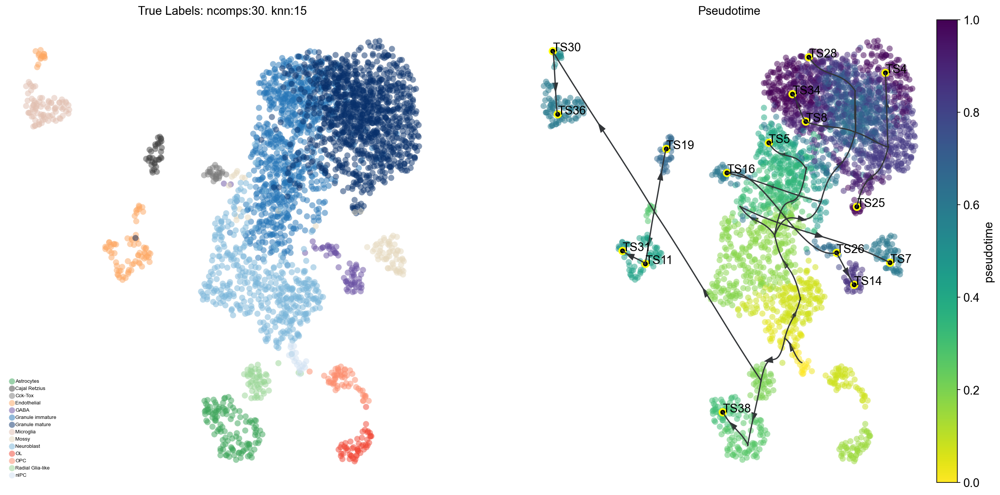

In [11]:
fig, ax, ax1 = VIA.core.plot_trajectory_curves_ov(adata,clusters='clusters',dpi=80,
                                                  via_object=v0,embedding=adata.obsm['X_umap'],
                                               draw_all_curves=False)


2024-12-17 21:42:19.896260	Computing Edges
2024-12-17 21:42:19.896311	Start finding milestones
2024-12-17 21:42:20.368246	End milestones with 150
2024-12-17 21:42:20.371431	Recompute weights
2024-12-17 21:42:20.380990	pruning milestone graph based on recomputed weights
2024-12-17 21:42:20.381684	Graph has 1 connected components before pruning
2024-12-17 21:42:20.382195	Graph has 7 connected components after pruning
2024-12-17 21:42:20.386902	Graph has 1 connected components after reconnecting
2024-12-17 21:42:20.387577	regenerate igraph on pruned edges
2024-12-17 21:42:20.393241	Setting numeric label as time_series_labels or other sequential metadata for coloring edges
2024-12-17 21:42:20.401529	Making smooth edges
inside add sc embedding second if


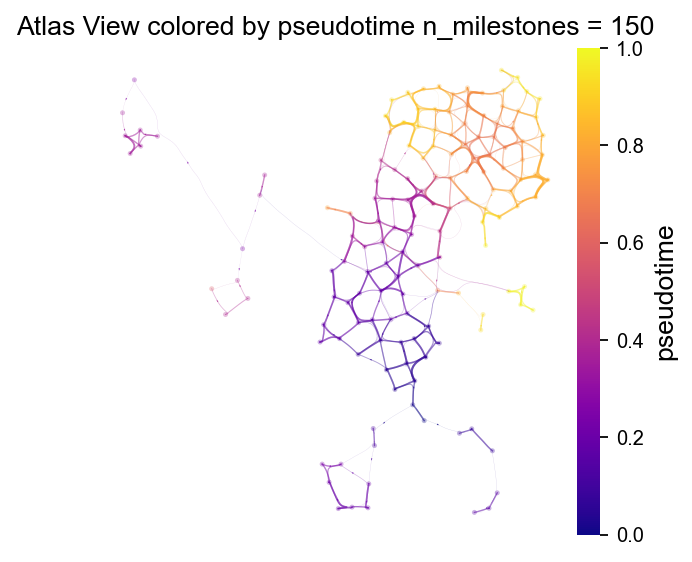

In [15]:
v0.embedding = adata.obsm['X_umap']
fig, ax = VIA.core.plot_atlas_view(via_object=v0, 
                                   n_milestones=150, 
                                   sc_labels=adata.obs['clusters'], 
                                   fontsize_title=12,
                                   fontsize_labels=12,dpi=80,
                                   extra_title_text='Atlas View colored by pseudotime')
fig.set_size_inches(4,4)

In [18]:
# edge plots can be made with different edge resolutions. Run hammerbundle_milestone_dict() to recompute the edges for plotting. Then provide the new hammerbundle as a parameter to plot_edge_bundle()
# it is better to compute the edges and save them to the via_object. this gives more control to the merging of edges
decay = 0.6 #increasing decay increasing merging of edges
i_bw = 0.02 #increasing bw increases merging of edges
global_visual_pruning = 0.5 #higher number retains more edges
n_milestones = 200

v0.hammerbundle_milestone_dict= VIA.core.make_edgebundle_milestone(via_object=v0, 
                                                              n_milestones=n_milestones, 
                                                              decay=decay, initial_bandwidth=i_bw,
                                                              global_visual_pruning=global_visual_pruning)


2024-12-17 21:42:55.254801	Start finding milestones
2024-12-17 21:42:55.870327	End milestones with 200
2024-12-17 21:42:55.873729	Recompute weights
2024-12-17 21:42:55.886283	pruning milestone graph based on recomputed weights
2024-12-17 21:42:55.887059	Graph has 1 connected components before pruning
2024-12-17 21:42:55.887595	Graph has 5 connected components after pruning
2024-12-17 21:42:55.891122	Graph has 1 connected components after reconnecting
2024-12-17 21:42:55.891964	regenerate igraph on pruned edges
2024-12-17 21:42:55.898723	Setting numeric label as single cell pseudotime for coloring edges
2024-12-17 21:42:55.908959	Making smooth edges


inside add sc embedding second if


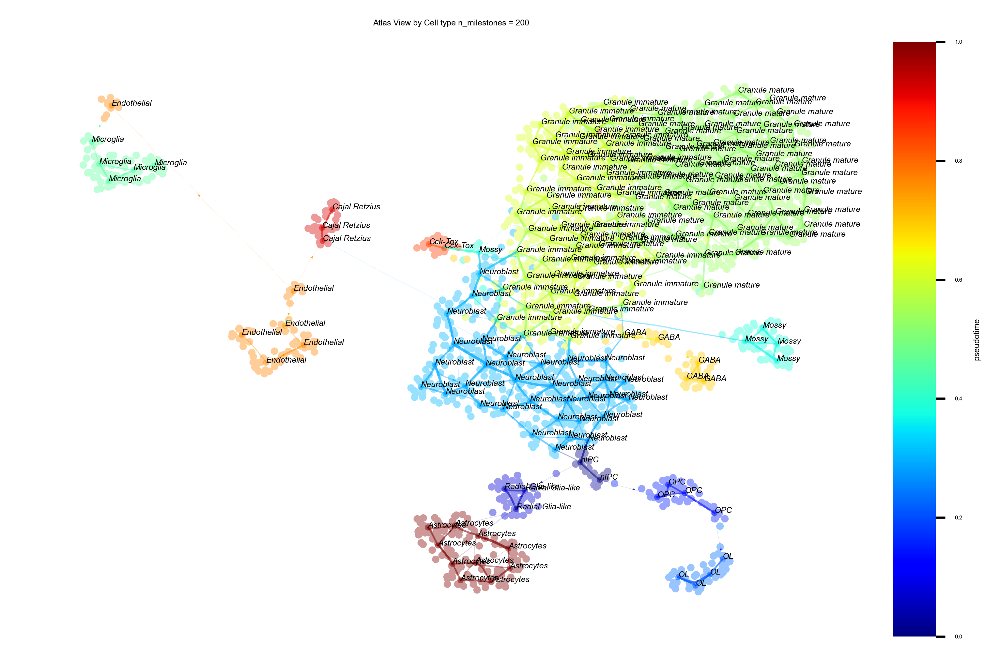

In [22]:
fig, ax = VIA.core.plot_atlas_view(via_object=v0,  
                              add_sc_embedding=True, 
                              sc_labels_expression=adata.obs['clusters'], 
                              cmap='jet', sc_labels=adata.obs['clusters'], 
                              text_labels=True, 
                              extra_title_text='Atlas View by Cell type', 
                              fontsize_labels=3,fontsize_title=3,dpi=300
                             )
fig.set_size_inches(6,4)

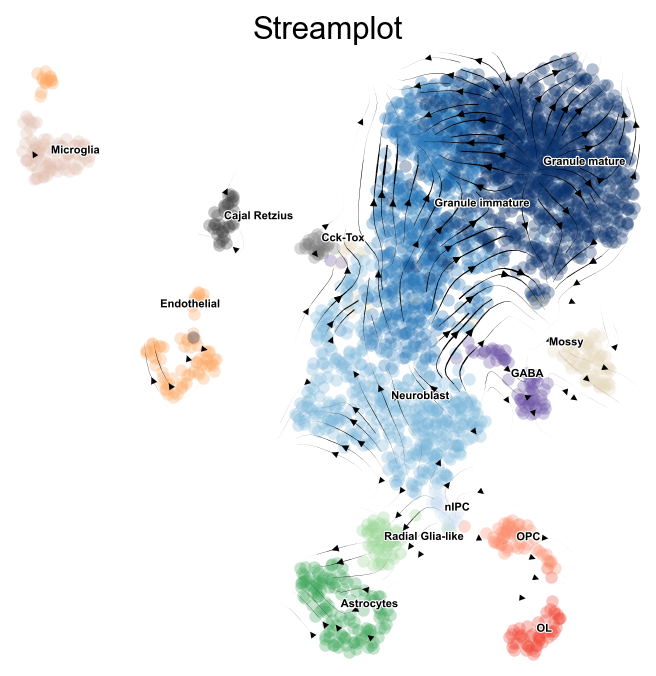

In [28]:
# via_streamplot() requires you to either provide an ndarray as embedding as an input parameter OR for via to have an embedding attribute
fig, ax = VIA.core.via_streamplot_ov(adata,'clusters',
                                     v0, embedding=adata.obsm['X_umap'], dpi=80,
                             density_grid=0.8, scatter_size=30, 
                             scatter_alpha=0.3, linewidth=0.5)
fig.set_size_inches(5,5)

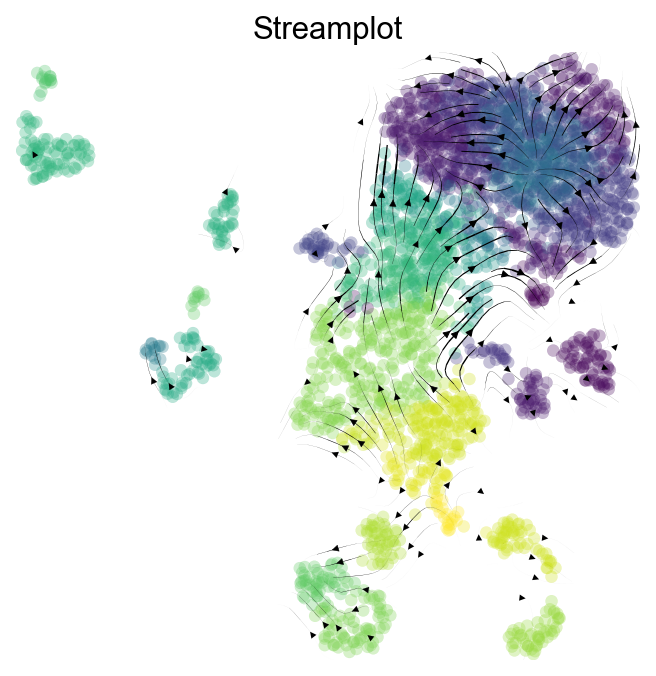

In [32]:
#Colored by pseudotime

fig, ax = VIA.core.via_streamplot_ov(adata,'clusters',
                             v0,density_grid=0.8, scatter_size=30, color_scheme='time', linewidth=0.5, 
                             min_mass = 1, cutoff_perc = 5, scatter_alpha=0.3, marker_edgewidth=0.1, 
                             density_stream = 2, smooth_transition=1, smooth_grid=0.5,dpi=80,)
fig.set_size_inches(5,5)

## Probabilistic pathways and Memory

Visualize the probabilistic pathways from root to terminal state as indicated by the lineage likelihood. The higher the linage likelihood, the greater the potential of that particular cell to differentiate towards the terminal state of interest. Changing the memory paramater will alter the specificity of the lineage pathway. This can be visualized at the single-cell level but also combined with the Atlas View which visualizes cell-cell connectivity and pathways

Key Parameters:
- marker_lineages (list) of terminal clusters

2024-12-17 21:48:09.698594	Marker_lineages: [34, 4, 5, 36, 7, 8, 38, 11, 12, 14, 19, 25, 28, 30, 31]
2024-12-17 21:48:09.700021	The number of components in the original full graph is 1
2024-12-17 21:48:09.700039	For downstream visualization purposes we are also constructing a low knn-graph 
2024-12-17 21:48:13.845602	Check sc pb 1.0 
f getting majority comp
2024-12-17 21:48:13.875623	Cluster path on clustergraph starting from Root Cluster 33 to Terminal Cluster 34: [33, 23, 2, 1, 3, 24, 18, 37, 6, 34]
2024-12-17 21:48:13.875656	Cluster path on clustergraph starting from Root Cluster 33 to Terminal Cluster 4: [33, 23, 2, 1, 3, 24, 18, 37, 6, 22, 4]
2024-12-17 21:48:13.875677	Cluster path on clustergraph starting from Root Cluster 33 to Terminal Cluster 5: [33, 23, 2, 1, 3, 24, 18, 37, 6, 5]
2024-12-17 21:48:13.875696	Cluster path on clustergraph starting from Root Cluster 33 to Terminal Cluster 36: [33, 23, 21, 40, 36]
2024-12-17 21:48:13.875718	Cluster path on clustergraph starting fro

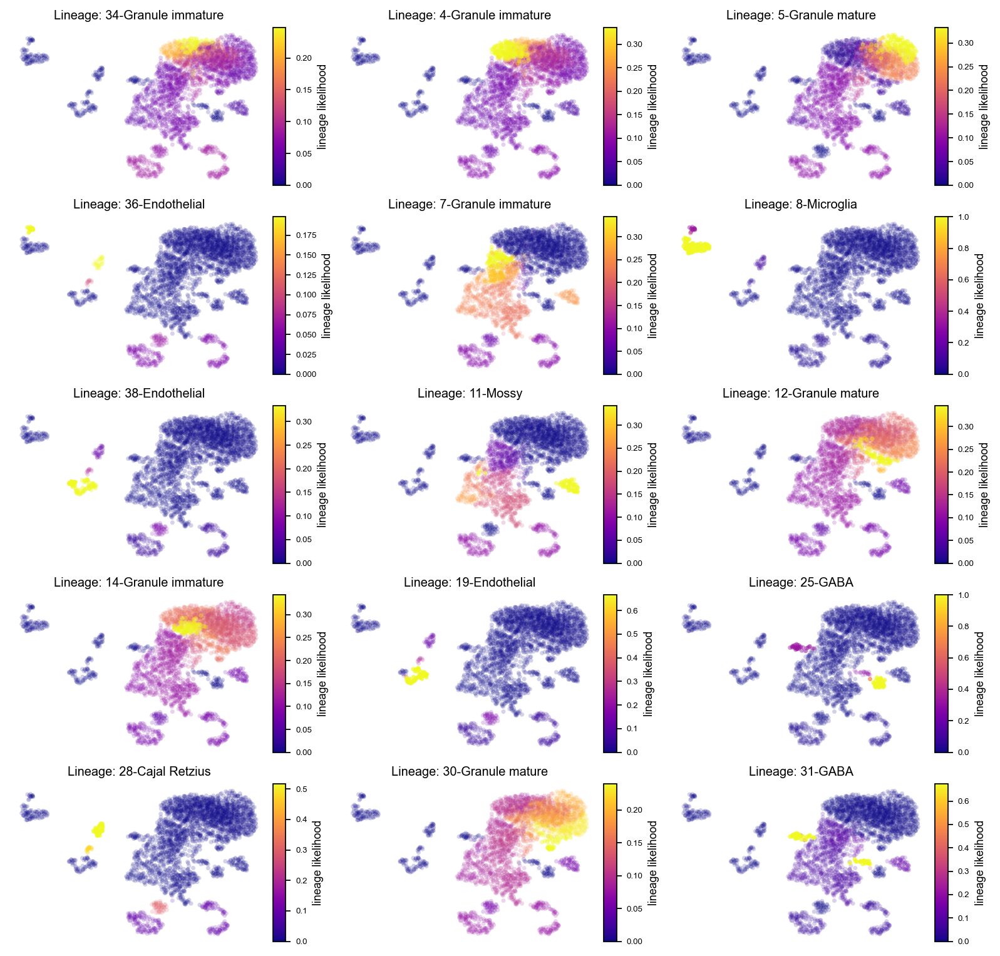

In [35]:
fig, axs= VIA.core.plot_sc_lineage_probability(via_object=v0, dpi=80,
                                          #marker_lineages=[7,11,12,15,20,22], 
                                          embedding=adata.obsm['X_umap']) #marker_lineages=v0.terminal_clusters to plot all
fig.set_size_inches(12,12)

location of 5 is at [2] and 2
setting vmin to 0.0
location of 25 is at [11] and 11
setting vmin to 0.0
location of 4 is at [1] and 1
setting vmin to 0.0


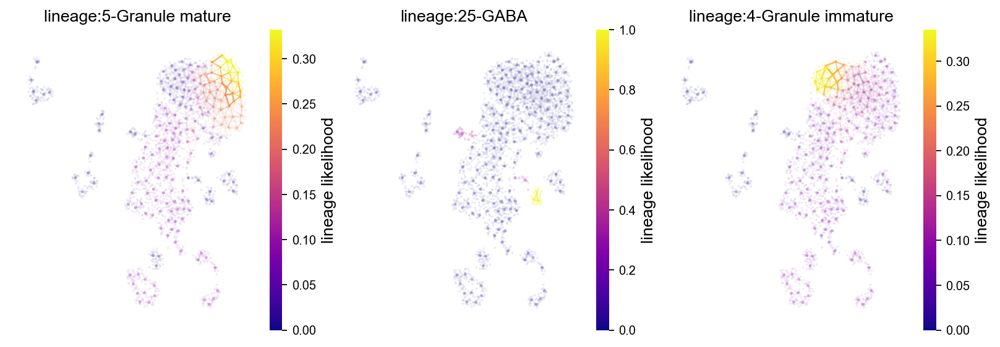

In [40]:
fig, axs= VIA.core.plot_atlas_view(via_object=v0, dpi=80,
                              lineage_pathway=[5,25,4],
                                   fontsize_title = 12,
                                 fontsize_labels = 12,
                             ) #marker_lineages=v0.terminal_clusters to plot all
fig.set_size_inches(12,4)

## Visualise gene/feature graph

View the gene expression along the VIA graph. We use the computed HNSW small world graph in VIA to accelerate the gene imputation calculations (using similar approach to MAGIC) as follows:

In [9]:
import pandas as pd
gene_list_magic =['Tmsb10', 'Hn1', ]
df = adata.to_df()
df_magic = v0.do_impute(df, magic_steps=3, gene_list=gene_list_magic) #optional

shape of transition matrix raised to power 3 (2930, 2930)


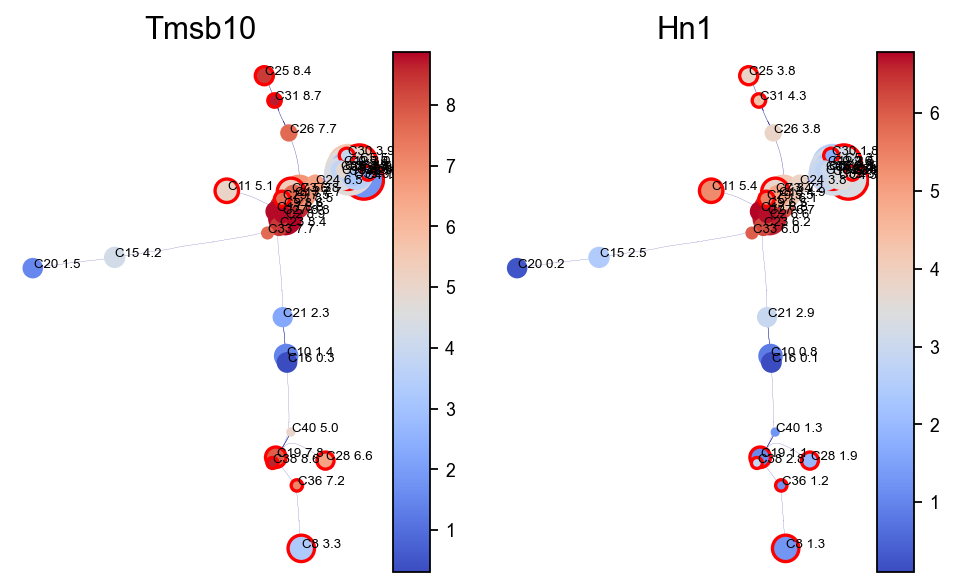

In [10]:
fig, axs = VIA.core.plot_viagraph(via_object=v0, 
                                  type_data='gene',
                                  df_genes=df_magic, 
                                  gene_list=gene_list_magic[0:3], arrow_head=0.1)
fig.set_size_inches(12,4)

## Gene Dynamics

The gene dynamics along pseudotime for all detected lineages are automatically inferred by VIA. These can be interpreted as the change in gene expression along any given lineage.

Key Parameters
- n_splines
- spline_order
- gene_exp (dataframe) single-cell level gene expression of select genes (gene imputation is an optional pre-step)

shape of transition matrix raised to power 3 (2930, 2930)
Area under curve Tmsb10 for branch Granule immature is 5.580818079102432
Area under curve Tmsb10 for branch Granule immature is 5.6305885516322896
Area under curve Tmsb10 for branch Granule mature is 6.09801291248822
Area under curve Tmsb10 for branch Endothelial is 0.8029748380565134
Area under curve Tmsb10 for branch Granule immature is 4.553506054484809
Area under curve Tmsb10 for branch Microglia is 1.394565066745735
Area under curve Tmsb10 for branch Endothelial is 3.151271164024714
Area under curve Tmsb10 for branch Mossy is 6.381610292676225
Area under curve Tmsb10 for branch Granule mature is 6.013508411025893
Area under curve Tmsb10 for branch Granule immature is 5.664759428181174
Area under curve Tmsb10 for branch Endothelial is 1.5305425977544975
Area under curve Tmsb10 for branch GABA is 7.320013684508645
Area under curve Tmsb10 for branch Cajal Retzius is 1.3306728398525145
Area under curve Tmsb10 for branch Granule

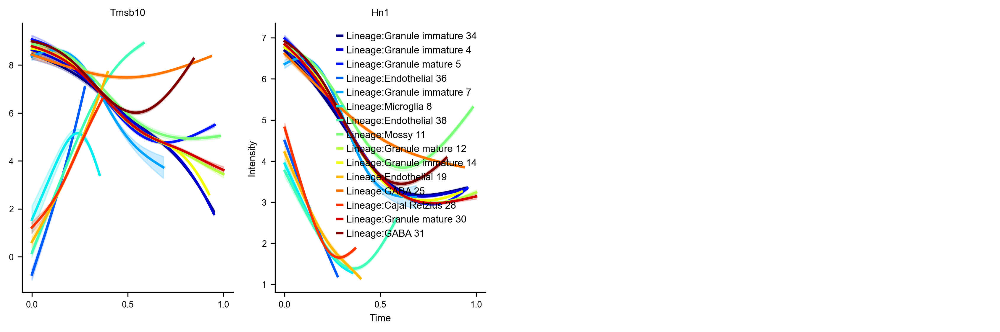

In [53]:
fig, axs=VIA.core.get_gene_expression(via_object=v0, #cmap_dict=color_dict,
                                      gene_exp=df_magic[gene_list_magic])
fig.set_size_inches(14,4)

branches [34, 5]


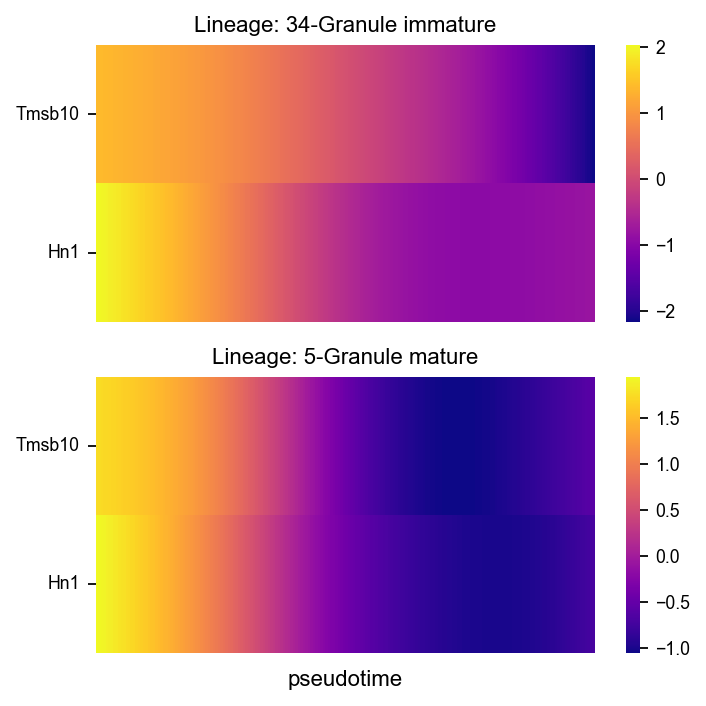

In [54]:
fig, axs = VIA.core.plot_gene_trend_heatmaps(via_object=v0, 
                                             df_gene_exp=df_magic, cmap='plasma',
                                         marker_lineages=[34,5])
fig.set_size_inches(5,5)

In [ ]:
VIA.core.animate_streamplot_ov(adata,'clusters',v0, embedding=adata.obsm['X_umap'],
                       cmap_stream='Blues', 
                       scatter_size=200, scatter_alpha=0.2, marker_edgewidth=0.15, 
                        density_grid=0.7, linewidth=0.1, 
                       segment_length=1.5, 
                       saveto='result/animation_test.gif')

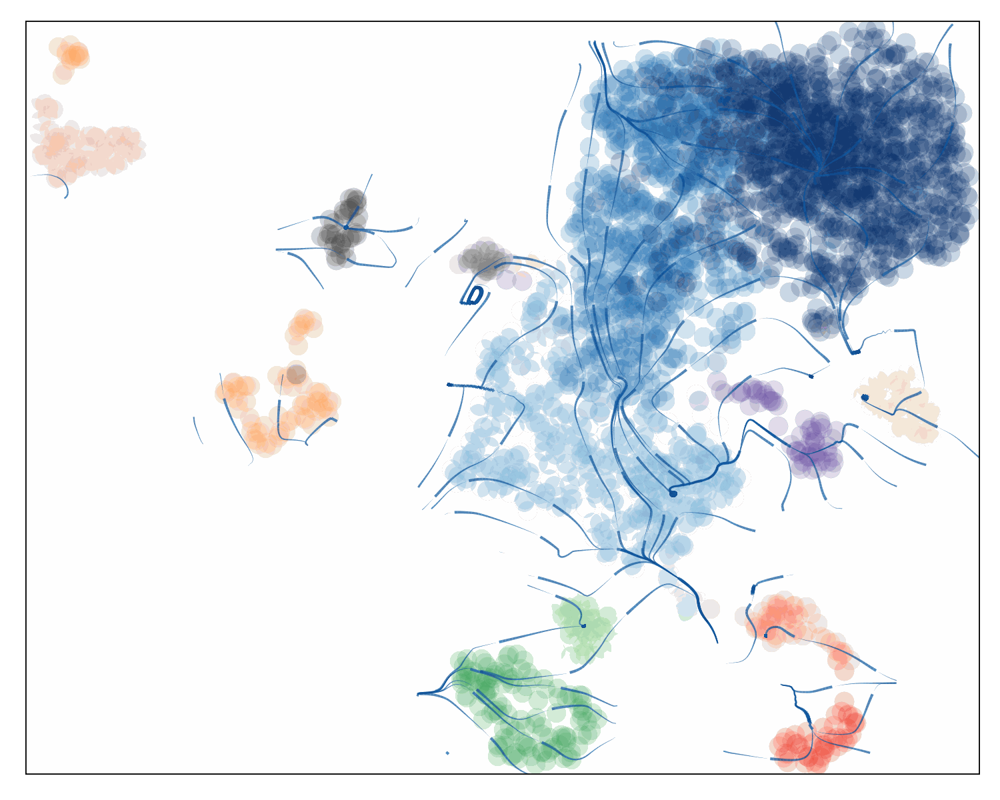

In [15]:
from IPython.display import Image

with open('result/animation_test.gif','rb') as file:
    display(Image(file.read(),width=500,height=500))

2024-12-17 23:12:45.801200	WARNING: VIA will now autocompute an embedding. It would be better to precompute an embedding using embedding = via_umap() or via_mds() and setting this as the embedding attribute via_object = embedding.
2024-12-17 23:12:45.801238	Commencing Via-MDS
minrowznormed -1.1457306
2024-12-17 23:12:46.667249	Start computing with diffusion power:1
2024-12-17 23:12:46.698075	Starting MDS on milestone
2024-12-17 23:12:49.146084	End computing mds with diffusion power:1
2024-12-17 23:12:49.147311	Start finding milestones
2024-12-17 23:12:49.545404	End milestones with 150
2024-12-17 23:12:49.548162	Recompute weights
2024-12-17 23:12:49.555214	pruning milestone graph based on recomputed weights
2024-12-17 23:12:49.555902	Graph has 1 connected components before pruning
2024-12-17 23:12:49.556430	Graph has 6 connected components after pruning
2024-12-17 23:12:49.560482	Graph has 1 connected components after reconnecting
2024-12-17 23:12:49.561170	regenerate igraph on pruned e

MovieWriter imagemagick unavailable; using Pillow instead.


ee 3
sorted numeric milestone 0.0
sorted numeric milestone 0.0
sorted numeric milestone 0.0
seg weight 0.18398711139673615
2024-12-17 23:12:49.937193	here1 in animate()
here2 in animate()
2024-12-17 23:12:49.944236	Finished plotting edge bundle
complete animate
0 out of 50 cycles
0 out of 50 cycles
1 out of 50 cycles
2 out of 50 cycles
3 out of 50 cycles
4 out of 50 cycles
5 out of 50 cycles
6 out of 50 cycles
7 out of 50 cycles
8 out of 50 cycles
9 out of 50 cycles
10 out of 50 cycles
11 out of 50 cycles
12 out of 50 cycles
13 out of 50 cycles
14 out of 50 cycles
15 out of 50 cycles
16 out of 50 cycles
17 out of 50 cycles
18 out of 50 cycles
19 out of 50 cycles
20 out of 50 cycles
21 out of 50 cycles
22 out of 50 cycles
23 out of 50 cycles
24 out of 50 cycles
25 out of 50 cycles
26 out of 50 cycles
27 out of 50 cycles
28 out of 50 cycles
29 out of 50 cycles
30 out of 50 cycles
31 out of 50 cycles
32 out of 50 cycles
33 out of 50 cycles
34 out of 50 cycles
35 out of 50 cycles
36 out of

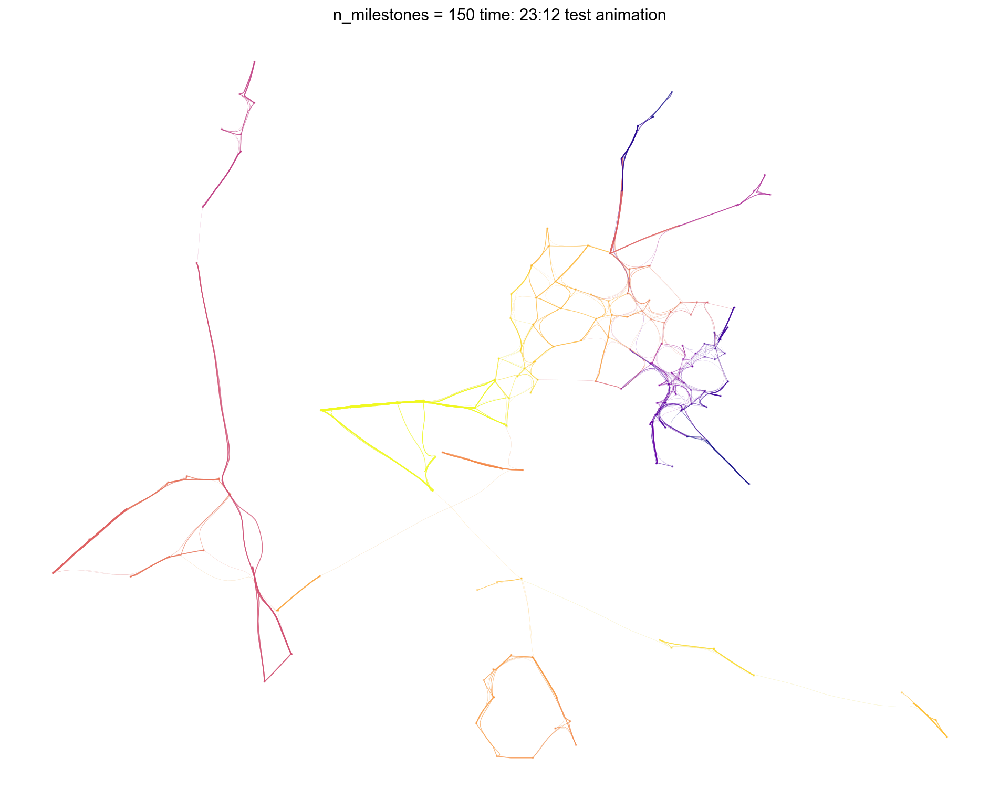

In [17]:
VIA.core.animate_atlas(via_object=v0, 
                        extra_title_text='test animation',
                        n_milestones=None,
                        saveto='result/edgebundle_test.gif')

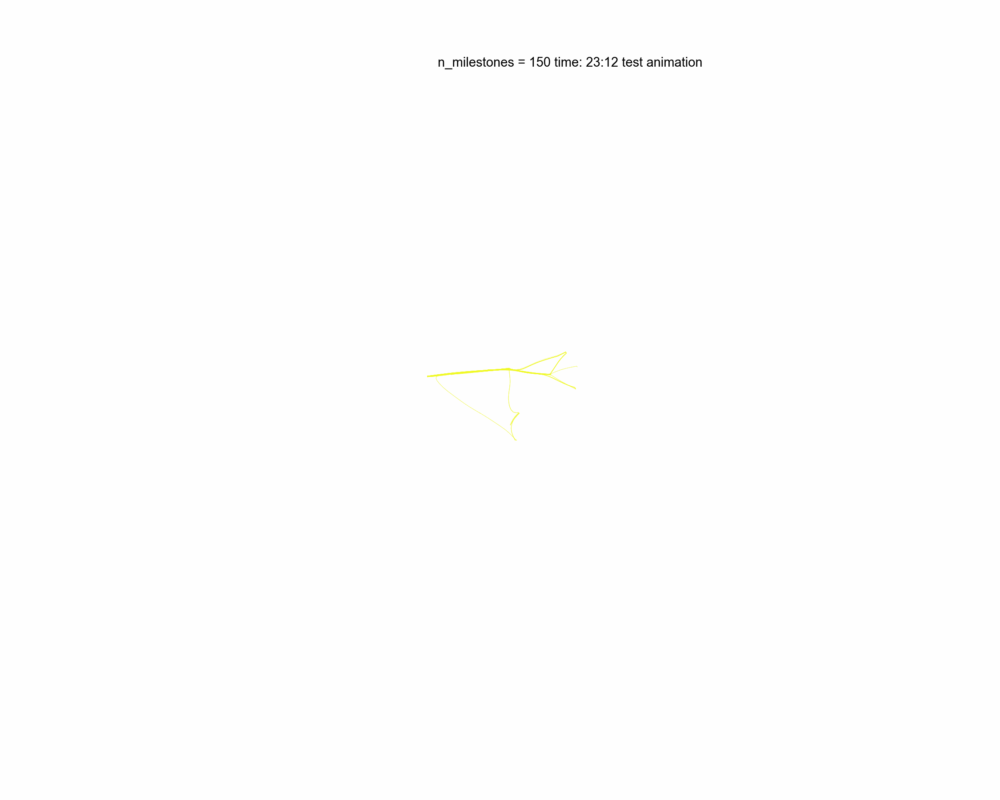

In [18]:
from IPython.display import Image

with open('result/edgebundle_test.gif','rb') as file:
    display(Image(file.read(),width=500,height=500))